# Pix2Pix  
- tensorflow로 구현

In [1]:
import numpy as np
import os
import time
import random
import matplotlib.pyplot as plt
from PIL import Image
import glob
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Flatten, Dropout
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.layers import Conv2DTranspose, LeakyReLU, Dense
from tensorflow.keras.layers import BatchNormalization, Activation, concatenate
from tensorflow.keras.optimizers import Adam

In [2]:
%matplotlib inline

In [3]:
import warnings
warnings.filterwarnings('ignore')

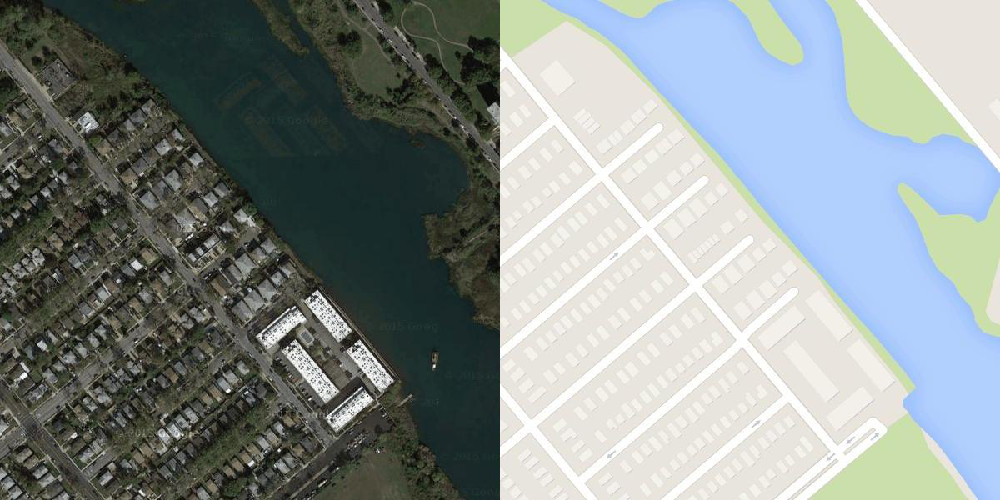

In [4]:
# show sample image
ex_path = r'C:\Users\user\MY_DL\GAN\pix2pix_datas\map\map (3274).jpg'
Image.open(ex_path)

In [6]:
# load dataset
data_dir = glob.glob('pix2pix_datas'+'/**/*.jpg')
random.shuffle(data_dir)

def load_images(files):
    image_list, mask_list = [], []
    for file in tqdm(files):
        # open image
        img = Image.open(file)
        img = img.resize((512,256))
        # transfer array type
        img = np.array(img).astype('float32')
        # original image has an image and a mask together
        image = img[:,:img.shape[1]//2,:]
        mask = img[:,img.shape[1]//2:,:]
        image_list.append(image)
        mask_list.append(mask)
    # return images data and mask data
    image_list = np.array(image_list)/127.5-1
    mask_list = np.array(mask_list)/127.5-1
    
    return image_list, mask_list

img_A, img_B = load_images(data_dir)

  0%|          | 0/2356 [00:00<?, ?it/s]

In [7]:
# create dataset batch
batch_size = 32
dataset = tf.data.Dataset.from_tensor_slices((img_A, img_B)).shuffle(1000)
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

### Define Models

In [8]:
# define encoder network
class UNetEncoder(Model):
    def __init__(self, num_filters, normalize=True, **kwargs):
        super(UNetEncoder, self).__init__()
        # build down sampling layer
        layers = [Conv2D(num_filters, (4,4), strides=2, padding='same')]
        if normalize:
            layers.append(BatchNormalization())
        layers.append(LeakyReLU(0.2))
        self.model = Sequential(layers)
        
    def call(self, x):
        return self.model(x)

In [9]:
# define decoder network
class UNetDecoder(Model):
    def __init__(self, num_filters):
        super(UNetDecoder, self).__init__()
        layers = [
            Conv2DTranspose(num_filters, (4,4), strides=2, padding='same'),
            BatchNormalization(),
            Activation('relu'),
        ]
        self.model = Sequential(layers)
        
    def call(self, x, skip_layer):
        x = self.model(x)
        x = concatenate([x, skip_layer], axis=3)
        return x

In [10]:
# define generator model
class Generator(Model):
    def __init__(self, out_channels=3):
        super(Generator, self).__init__()
        # input size is 128x128x3
        self.encoder1 = UNetEncoder(64, normalize=False)
        # output size is 64x64x64
        self.encoder2 = UNetEncoder(128)
        # output size is 32x32x128
        self.encoder3 = UNetEncoder(256)
        # output size is 16x16x256
        self.encoder4 = UNetEncoder(512)
        # output size is 8x8x512
        self.encoder5 = UNetEncoder(512)
        # output size is 4x4x512
        self.encoder6 = UNetEncoder(512)
        # output size is 2x2x512
        self.encoder7 = UNetEncoder(512)
        # output size is 2x2x512
        self.encoder8 = UNetEncoder(512, normalize=False)
        # output size is 1x1x512
        
        # input size is 1x1x512
        self.decoder1 = UNetDecoder(512)
        # output size is 2x2x512 + skip layer (4x4x512)
        self.decoder2 = UNetDecoder(512)
        # output size is 4x4x512 + skip layer (8x8x512)
        self.decoder3 = UNetDecoder(512)
        # output size is 8x8x512 + skip layer (16x16x512)
        self.decoder4 = UNetDecoder(512)
        # output size is 16x16x512 + skip layer (16x16x512)
        self.decoder5 = UNetDecoder(256)
        # output size is 32x32x256 + skip layer (32x32x512)
        self.decoder6 = UNetDecoder(128)
        # output size is 64x64x128 + skip layer (64x64x128)
        self.decoder7 = UNetDecoder(64)
        # output size is 128x128x64 + skip layer (128x128x64)
        self.decoder8 = Sequential([
            Conv2DTranspose(out_channels, (4,4), strides=2, padding='same'),
            Activation('tanh')
        ])
        # output size is 256x256x3
    
    def call(self, x):
        e1 = self.encoder1(x)
        e2 = self.encoder2(e1)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)
        e5 = self.encoder5(e4)
        e6 = self.encoder6(e5)
        e7 = self.encoder7(e6)
        e8 = self.encoder8(e7)
        # up-sampling with concatenate skip layers
        d1 = self.decoder1(e8, e7)
        d2 = self.decoder2(d1, e6)
        d3 = self.decoder3(d2, e5)
        d4 = self.decoder4(d3, e4)
        d5 = self.decoder5(d4, e3)
        d6 = self.decoder6(d5, e2)
        d7 = self.decoder7(d6, e1)
        d8 = self.decoder8(d7)
        return d8

In [11]:
# define discriminator model
class Discriminator(Model):
    def __init__(self):
        super(Discriminator, self).__init__()
        # define convolution block
        def discriminator_block(num_filters, normalize=True):
            layers = [Conv2D(num_filters, (4,4), strides=2, padding='same')]
            if normalize:
                layers.append(BatchNormalization())
            layers.append(Activation('relu'))
            return layers
        
        self.model = Sequential([
            # input size is 256x256x3 + 256x256x3
            *discriminator_block(64, normalize=False),
            # output size is 128x128x64
            *discriminator_block(128),
            # output size is 64x64x128
            *discriminator_block(256),
            # output size is 32x32x256
            *discriminator_block(512),
            # output size is 16x16x512
            keras.layers.ZeroPadding2D(padding=(0,0)),
            # output size is 17x17x512
            Conv2D(1, (4,4), padding='same'),
            Activation('sigmoid')
        ])
            # output size is 16x16x1
    
    def call(self, img_A, img_B):
        x = concatenate([img_A, img_B], axis=3)
        return self.model(x)

In [12]:
# load model
generator = Generator()
discriminator = Discriminator()

In [13]:
# set hyperparameter
patch = (16, 16, 1)
lambda_pixel = 20 # 100으로 설정할 경우 discriminator가 너무 빨리 학습해버려 20으로 다운그레이드
lr = 0.0002
beta1 = 0.5

# define optimizer
gen_optim = Adam(learning_rate=lr, beta_1=beta1)
dis_optim = Adam(learning_rate=lr, beta_1=beta1)

In [14]:
# show generated images every epochs
img_normal = lambda img: (img+1)/2

def plot_generated_images(inputs, ground_truth, generated, epoch, every):
    if epoch%every==0:
        for i in range(5):
            plt.figure(figsize=(12,4))
            plt.subplot(1,3,1)
            cod = img_normal(inputs[i])
            plt.imshow(cod)
            plt.axis('off')
            plt.title('Input Image')
            plt.subplot(1,3,2)
            org = img_normal(ground_truth[i])
            plt.imshow(org)
            plt.axis('off')
            plt.title('Ground Truth')
            plt.subplot(1,3,3)
            gen = img_normal(generated[i])
            plt.imshow(gen)
            plt.axis('off')
            plt.title('Generated Image')
            plt.show()

In [15]:
# define losses
bce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# generator loss 정의
def generator_loss(out_dis, fake_out, target):
    # discriminator의 output 사이즈에 맞는 라벨 생성
    real_label = tf.ones_like(out_dis)
    # discriminator의 출력값과 라벨 로스 구하기
    gen_loss = bce_loss(out_dis, real_label)
    # generator가 생성한 fake 이미지와 target의 L1 loss 구하기
    l1_loss = tf.reduce_mean(tf.abs(fake_out-target))
    total_gen_loss = gen_loss+lambda_pixel*l1_loss
    return total_gen_loss

# discriminator loss 정의
def discriminator_loss(real_out, fake_out):
    # patch 사이즈에 맞는 0으로 된 가짜 라벨 생성
    fake_label = tf.zeros_like(fake_out)
    # fake patch에 대한 loss 구하기
    fake_loss = bce_loss(fake_label, fake_out)
    # patch 사이즈에 맞는 1로 된 진짜 라벨 생성
    real_label = tf.ones_like(real_out)
    # real patch에 대한 loss 구하기
    real_loss = bce_loss(real_label, real_out)
    total_dis_loss = fake_loss+real_loss
    return total_dis_loss

In [16]:
# GAN 훈련
def train_gan(generator, discriminator, dataset, n_epochs, show_image_epoch):
    # loss 리스트 생성
    d_loss_list, g_loss_list = [], []
    starting = time.time()
    # n_epochs만큼 훈련 진행
    for epoch in tqdm(range(n_epochs)):
        initial_epoch = time.time()
        # mini-batch
        for img_A, img_B in dataset:
            with tf.GradientTape() as gen_tape, tf.GradientTape() as dis_tape:
                # step1: 진짜 이미지를 생성자에 입력
                fake_out = generator(img_A, training=True)
                # step2: 판별자에 진짜 이미지와 가짜 이미지 입력
                dis_real_out = discriminator(img_A, img_B)
                dis_fake_out = discriminator(img_A, fake_out)
                # step3: 판별자 로스 구하기
                d_loss = discriminator_loss(dis_real_out, dis_fake_out)
                # step4: 가짜이미지를 가지고 판별자 속이기
                g_loss = generator_loss(dis_fake_out, fake_out, img_B)
            # update loss
            gen_grad = gen_tape.gradient(g_loss, generator.trainable_variables)
            dis_grad = dis_tape.gradient(d_loss, discriminator.trainable_variables)
            # update optimizer
            gen_optim.apply_gradients(zip(gen_grad, generator.trainable_variables))
            dis_optim.apply_gradients(zip(dis_grad, discriminator.trainable_variables))
            
        d_loss_list.append(d_loss)
        g_loss_list.append(g_loss)
        # fake image 보여주기
        plot_generated_images(img_A, img_B, fake_out, epoch+1, show_image_epoch)
        end_epoch = time.time()
        print(f'Epoch {epoch+1}/{n_epochs}, time: {end_epoch-initial_epoch}s\nDiscriminator loss is {d_loss}, Generator_loss is {g_loss}')
        print('---------------------------------------------------------------------------------')
    ending = time.time()
    print(f'Total time of training is {ending-starting}')
    return img_A, img_B, fake_out, d_loss_list, g_loss_list

  0%|          | 0/100 [00:00<?, ?it/s]

Epoch 1/100, time: 25.99489974975586s
Discriminator loss is 1.1221215724945068, Generator_loss is 6.649600982666016
---------------------------------------------------------------------------------
Epoch 2/100, time: 21.66790008544922s
Discriminator loss is 0.8257784247398376, Generator_loss is 5.980358123779297
---------------------------------------------------------------------------------
Epoch 3/100, time: 22.640439748764038s
Discriminator loss is 0.9545156955718994, Generator_loss is 5.822952747344971
---------------------------------------------------------------------------------
Epoch 4/100, time: 22.32569670677185s
Discriminator loss is 1.0062508583068848, Generator_loss is 5.309326171875
---------------------------------------------------------------------------------


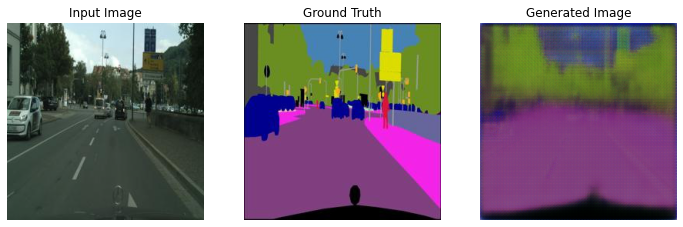

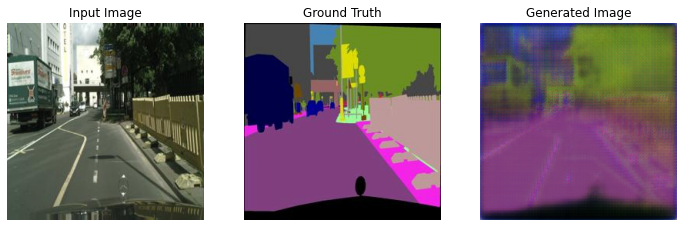

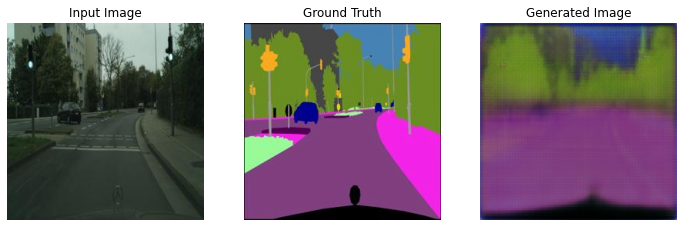

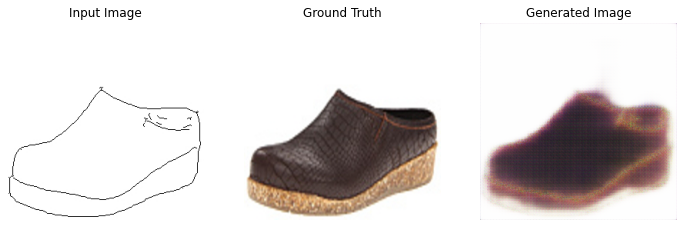

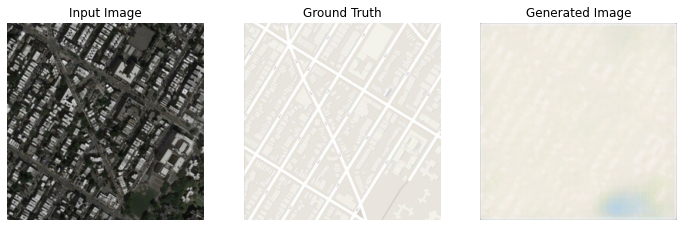

Epoch 5/100, time: 22.678248167037964s
Discriminator loss is 0.8033431768417358, Generator_loss is 5.502098560333252
---------------------------------------------------------------------------------
Epoch 6/100, time: 21.605600833892822s
Discriminator loss is 0.9219635725021362, Generator_loss is 4.829893112182617
---------------------------------------------------------------------------------
Epoch 7/100, time: 21.418487310409546s
Discriminator loss is 0.9007604718208313, Generator_loss is 4.715660095214844
---------------------------------------------------------------------------------
Epoch 8/100, time: 21.388273239135742s
Discriminator loss is 0.8109090328216553, Generator_loss is 5.083748817443848
---------------------------------------------------------------------------------
Epoch 9/100, time: 21.112607955932617s
Discriminator loss is 0.8045394420623779, Generator_loss is 6.079573631286621
---------------------------------------------------------------------------------


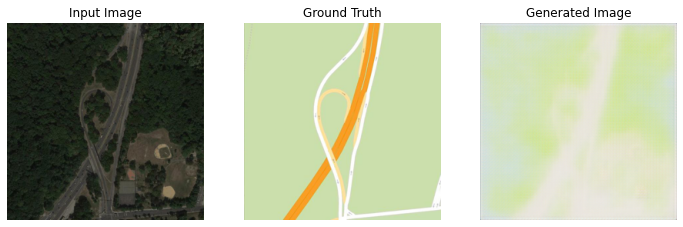

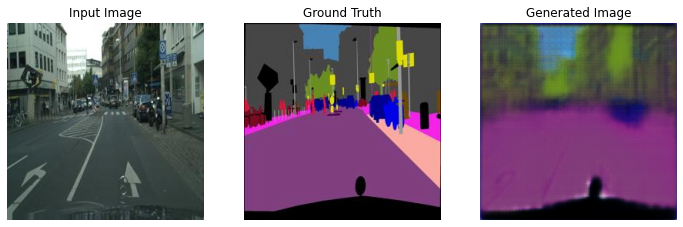

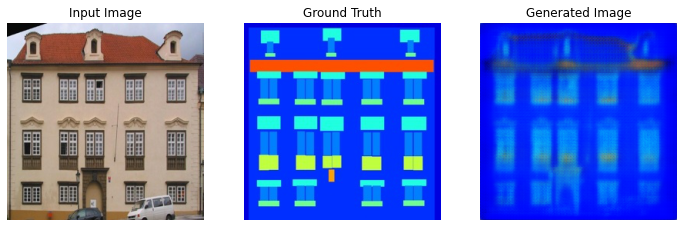

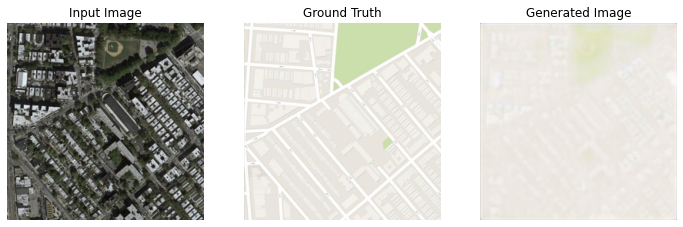

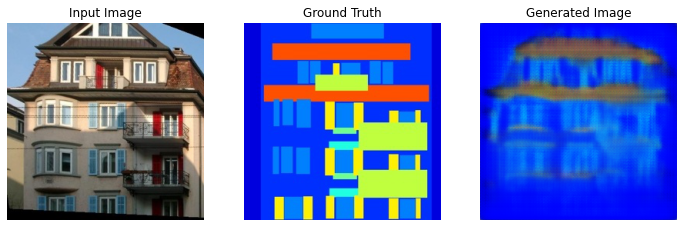

Epoch 10/100, time: 22.405554056167603s
Discriminator loss is 0.8454355001449585, Generator_loss is 4.582386016845703
---------------------------------------------------------------------------------
Epoch 11/100, time: 22.331836462020874s
Discriminator loss is 0.9831319451332092, Generator_loss is 4.405279636383057
---------------------------------------------------------------------------------
Epoch 12/100, time: 22.20789384841919s
Discriminator loss is 0.9351541996002197, Generator_loss is 5.2957658767700195
---------------------------------------------------------------------------------
Epoch 13/100, time: 22.08271050453186s
Discriminator loss is 0.7182987332344055, Generator_loss is 5.5525712966918945
---------------------------------------------------------------------------------
Epoch 14/100, time: 22.09338617324829s
Discriminator loss is 0.9227664470672607, Generator_loss is 4.043572902679443
---------------------------------------------------------------------------------


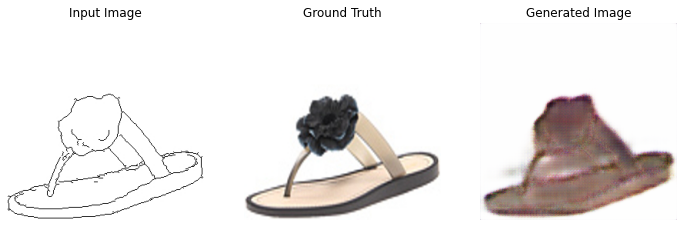

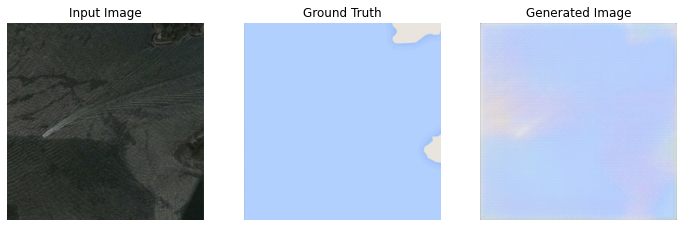

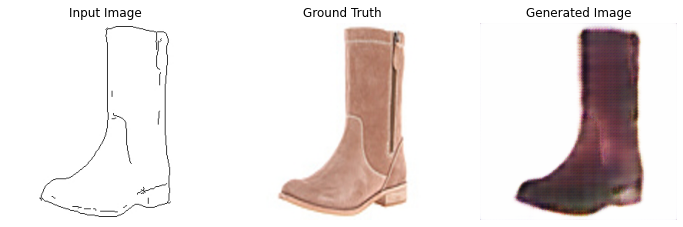

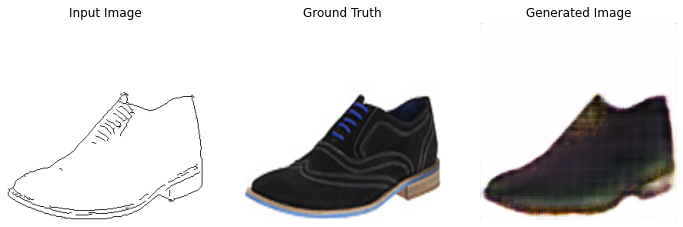

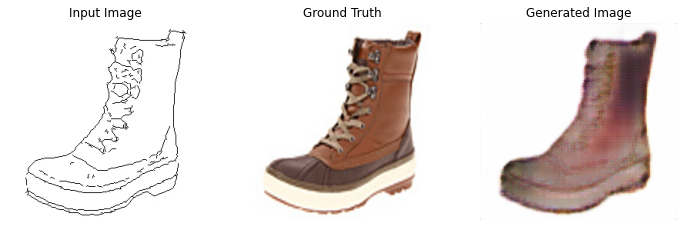

Epoch 15/100, time: 23.049388647079468s
Discriminator loss is 1.032464861869812, Generator_loss is 4.400487422943115
---------------------------------------------------------------------------------
Epoch 16/100, time: 22.222782611846924s
Discriminator loss is 0.9147474765777588, Generator_loss is 4.168887138366699
---------------------------------------------------------------------------------
Epoch 17/100, time: 22.324684619903564s
Discriminator loss is 0.8914166688919067, Generator_loss is 4.184081077575684
---------------------------------------------------------------------------------
Epoch 18/100, time: 22.23673415184021s
Discriminator loss is 0.948625922203064, Generator_loss is 4.621996879577637
---------------------------------------------------------------------------------
Epoch 19/100, time: 22.119640588760376s
Discriminator loss is 0.9366161227226257, Generator_loss is 4.114246368408203
---------------------------------------------------------------------------------


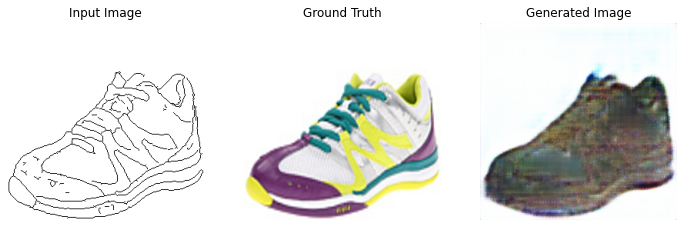

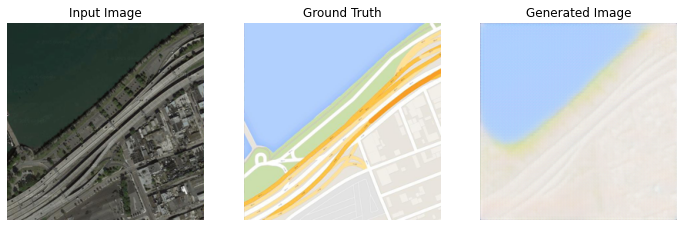

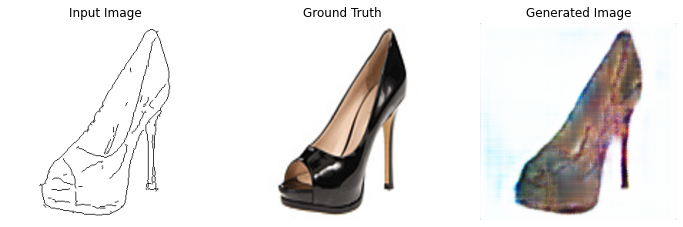

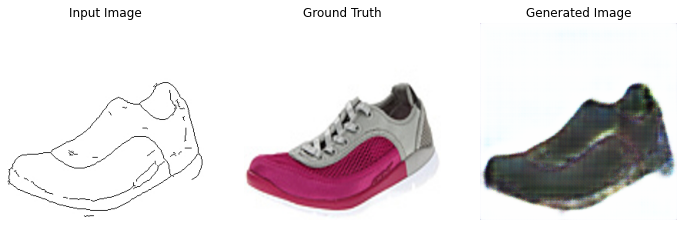

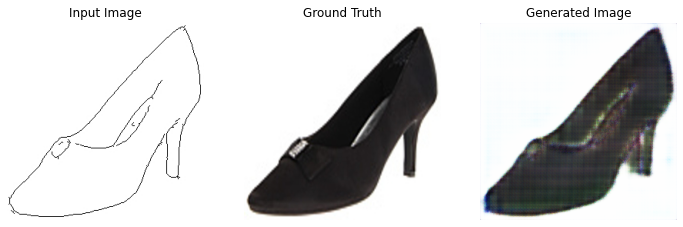

Epoch 20/100, time: 22.774422645568848s
Discriminator loss is 0.9059420824050903, Generator_loss is 3.876697540283203
---------------------------------------------------------------------------------
Epoch 21/100, time: 22.537785530090332s
Discriminator loss is 0.7976646423339844, Generator_loss is 4.112893104553223
---------------------------------------------------------------------------------
Epoch 22/100, time: 22.47898030281067s
Discriminator loss is 1.0490550994873047, Generator_loss is 4.145817279815674
---------------------------------------------------------------------------------
Epoch 23/100, time: 22.160677671432495s
Discriminator loss is 0.9050289392471313, Generator_loss is 4.805397033691406
---------------------------------------------------------------------------------
Epoch 24/100, time: 21.906524181365967s
Discriminator loss is 0.967788815498352, Generator_loss is 4.177047252655029
---------------------------------------------------------------------------------


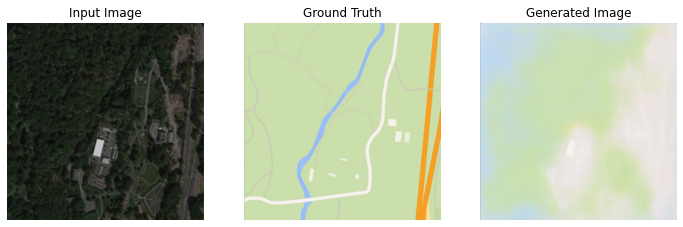

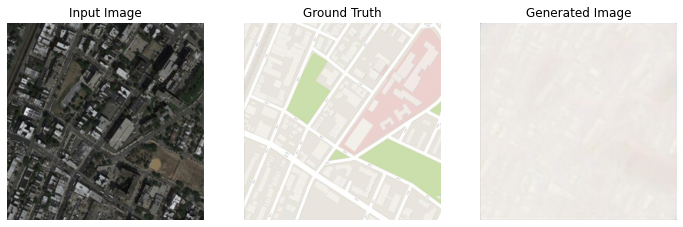

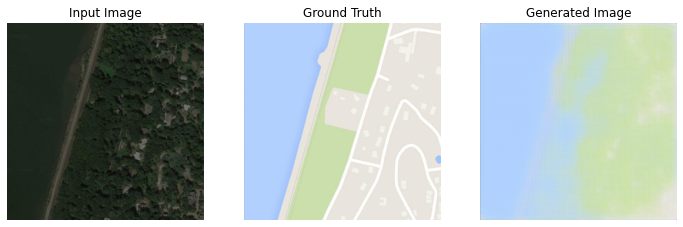

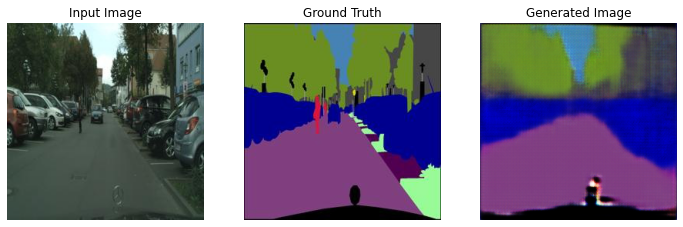

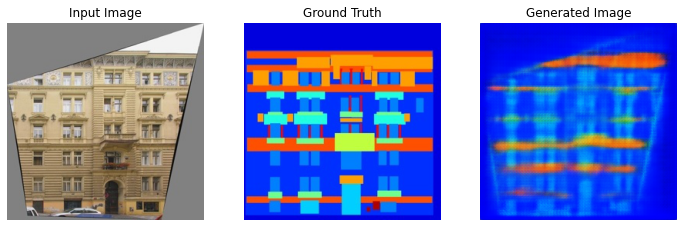

Epoch 25/100, time: 23.293444871902466s
Discriminator loss is 0.9681712985038757, Generator_loss is 3.9181857109069824
---------------------------------------------------------------------------------
Epoch 26/100, time: 21.379425048828125s
Discriminator loss is 0.792684018611908, Generator_loss is 4.228105545043945
---------------------------------------------------------------------------------
Epoch 27/100, time: 21.174171924591064s
Discriminator loss is 1.1222079992294312, Generator_loss is 4.069631576538086
---------------------------------------------------------------------------------
Epoch 28/100, time: 21.173781633377075s
Discriminator loss is 0.7970935106277466, Generator_loss is 4.8380537033081055
---------------------------------------------------------------------------------
Epoch 29/100, time: 21.21265697479248s
Discriminator loss is 0.773032546043396, Generator_loss is 5.153443336486816
---------------------------------------------------------------------------------


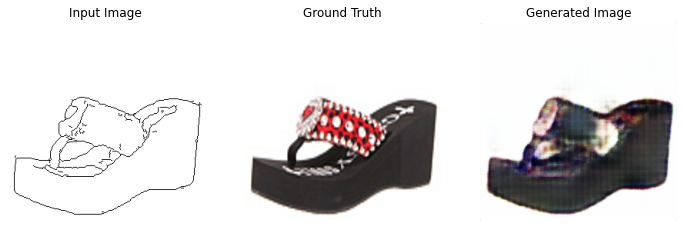

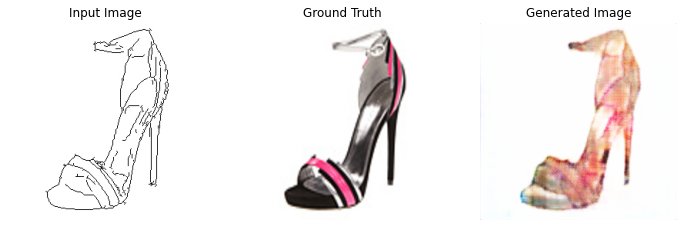

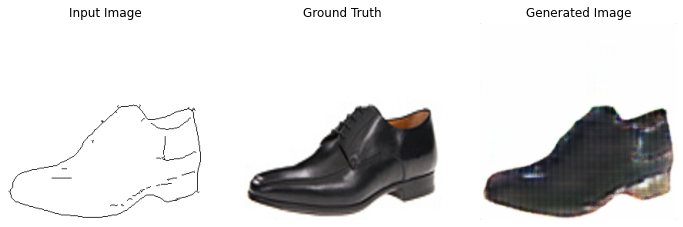

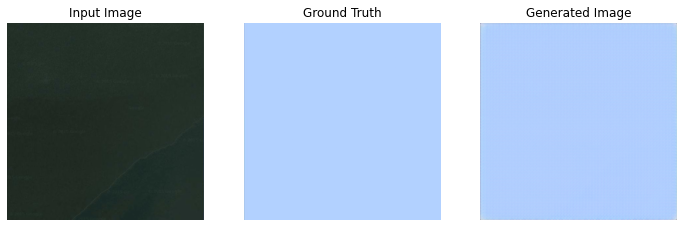

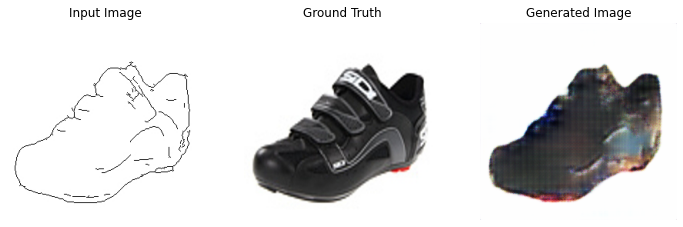

Epoch 30/100, time: 21.7911057472229s
Discriminator loss is 0.9999262094497681, Generator_loss is 3.192578077316284
---------------------------------------------------------------------------------
Epoch 31/100, time: 21.457008361816406s
Discriminator loss is 0.8353121280670166, Generator_loss is 4.3994646072387695
---------------------------------------------------------------------------------
Epoch 32/100, time: 21.6593279838562s
Discriminator loss is 0.7919174432754517, Generator_loss is 4.53508996963501
---------------------------------------------------------------------------------
Epoch 33/100, time: 21.262109994888306s
Discriminator loss is 0.9372618198394775, Generator_loss is 3.9774057865142822
---------------------------------------------------------------------------------
Epoch 34/100, time: 21.307079076766968s
Discriminator loss is 0.942620038986206, Generator_loss is 4.177652359008789
---------------------------------------------------------------------------------


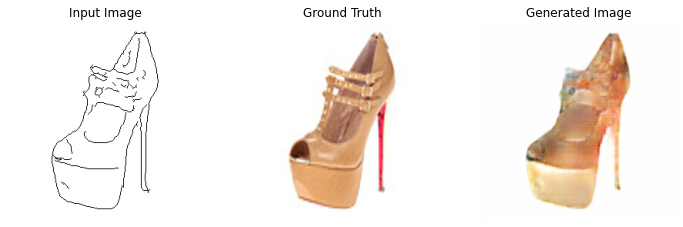

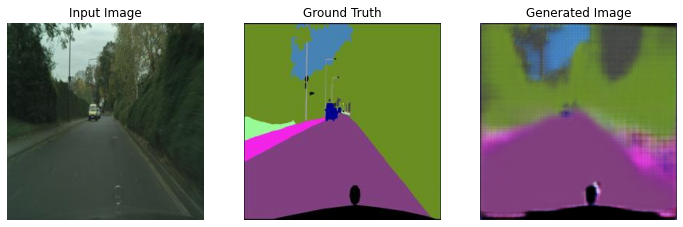

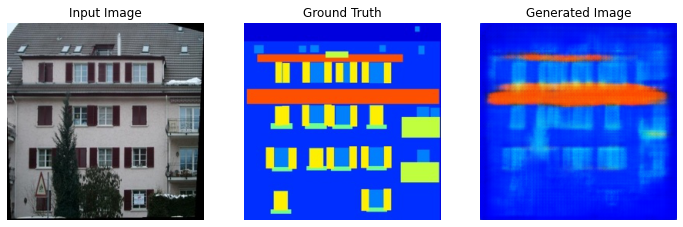

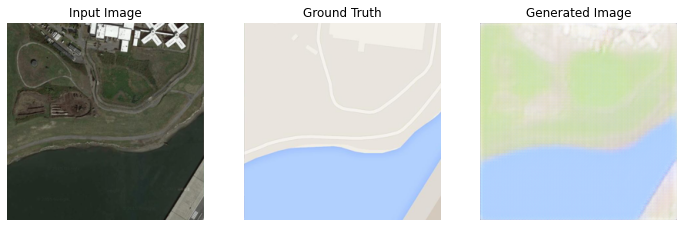

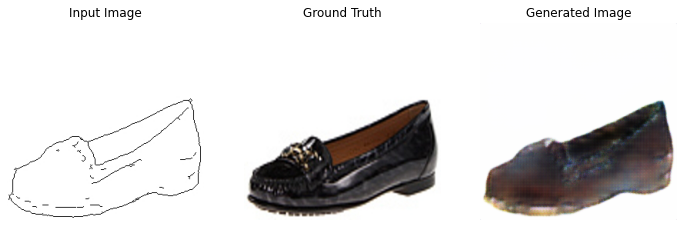

Epoch 35/100, time: 21.811418533325195s
Discriminator loss is 0.5300825238227844, Generator_loss is 4.263034820556641
---------------------------------------------------------------------------------
Epoch 36/100, time: 21.305089712142944s
Discriminator loss is 0.7002307176589966, Generator_loss is 4.382103443145752
---------------------------------------------------------------------------------
Epoch 37/100, time: 21.28083872795105s
Discriminator loss is 0.6340367197990417, Generator_loss is 4.375251770019531
---------------------------------------------------------------------------------
Epoch 38/100, time: 22.261686086654663s
Discriminator loss is 0.6265290975570679, Generator_loss is 4.454559326171875
---------------------------------------------------------------------------------
Epoch 39/100, time: 21.241270303726196s
Discriminator loss is 0.6364589929580688, Generator_loss is 4.556673526763916
---------------------------------------------------------------------------------


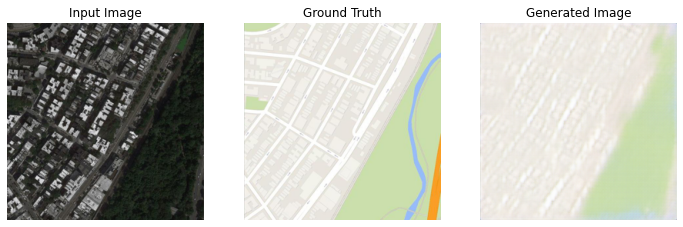

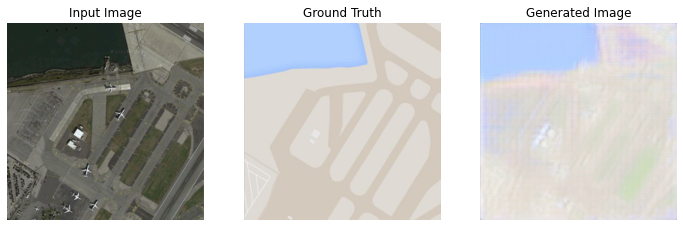

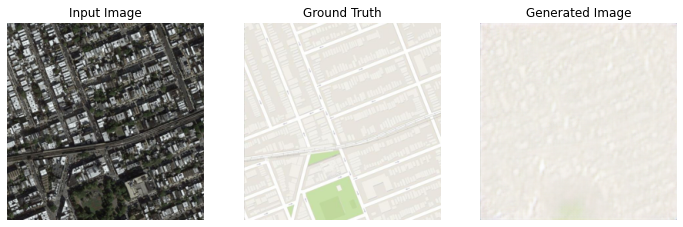

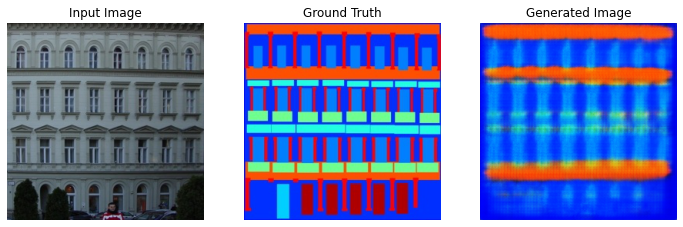

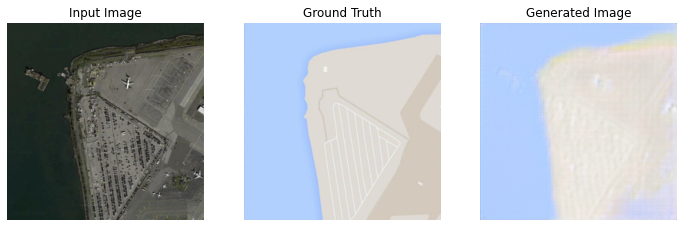

Epoch 40/100, time: 21.91132616996765s
Discriminator loss is 0.8333496451377869, Generator_loss is 3.8639588356018066
---------------------------------------------------------------------------------
Epoch 41/100, time: 21.465808629989624s
Discriminator loss is 1.0488922595977783, Generator_loss is 3.425663471221924
---------------------------------------------------------------------------------
Epoch 42/100, time: 21.220406532287598s
Discriminator loss is 0.8682557344436646, Generator_loss is 3.6834068298339844
---------------------------------------------------------------------------------
Epoch 43/100, time: 21.25368332862854s
Discriminator loss is 0.9252861738204956, Generator_loss is 3.573331594467163
---------------------------------------------------------------------------------
Epoch 44/100, time: 21.241125345230103s
Discriminator loss is 0.8122042417526245, Generator_loss is 3.293221950531006
---------------------------------------------------------------------------------


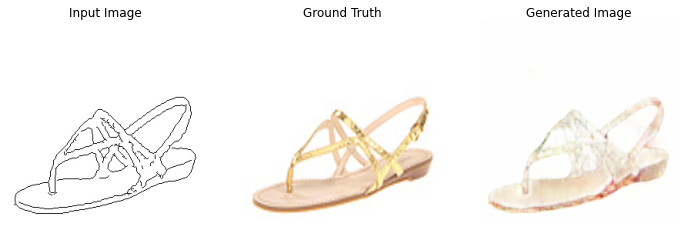

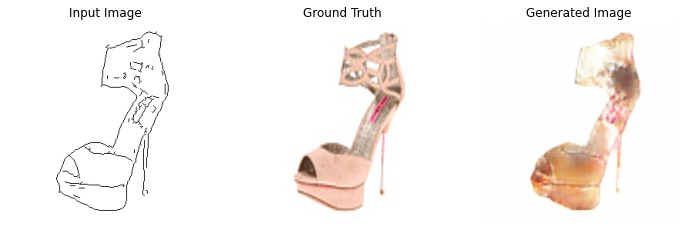

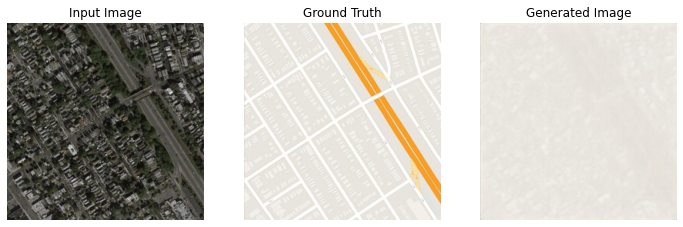

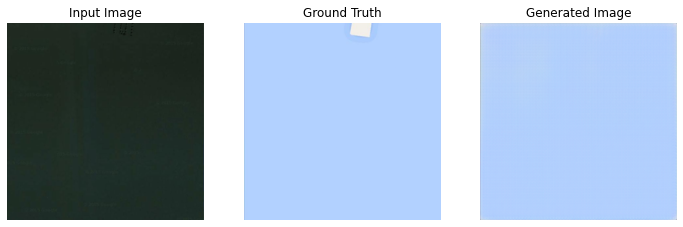

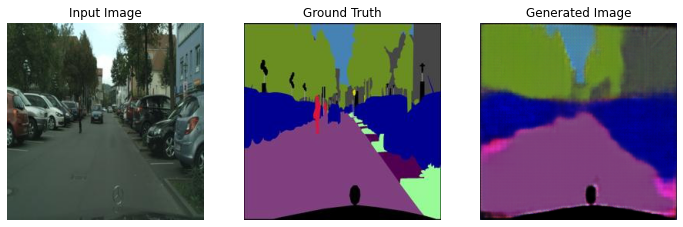

Epoch 45/100, time: 21.845179080963135s
Discriminator loss is 0.9164286851882935, Generator_loss is 3.471435785293579
---------------------------------------------------------------------------------
Epoch 46/100, time: 21.314993619918823s
Discriminator loss is 0.901310920715332, Generator_loss is 3.9481186866760254
---------------------------------------------------------------------------------
Epoch 47/100, time: 21.258787631988525s
Discriminator loss is 0.7478795051574707, Generator_loss is 3.603990077972412
---------------------------------------------------------------------------------
Epoch 48/100, time: 21.261650800704956s
Discriminator loss is 1.549582839012146, Generator_loss is 4.587180137634277
---------------------------------------------------------------------------------
Epoch 49/100, time: 21.23093867301941s
Discriminator loss is 0.7107699513435364, Generator_loss is 3.7167327404022217
---------------------------------------------------------------------------------


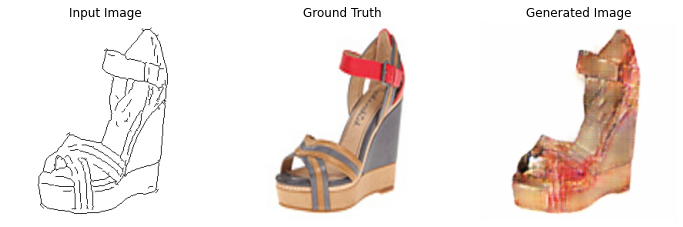

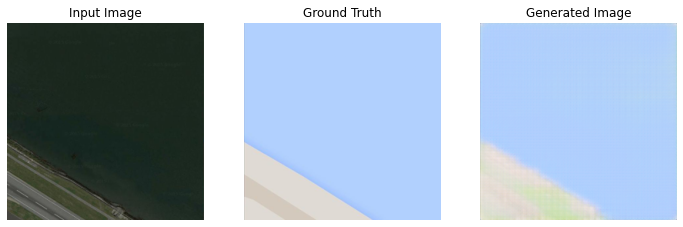

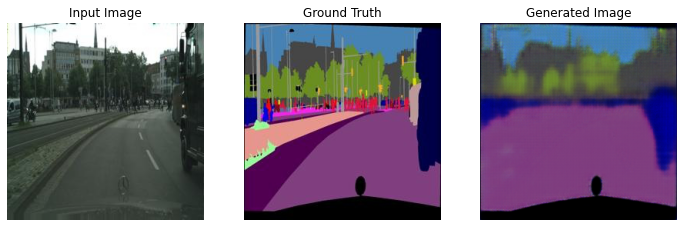

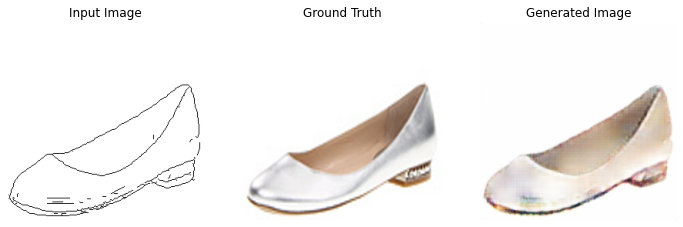

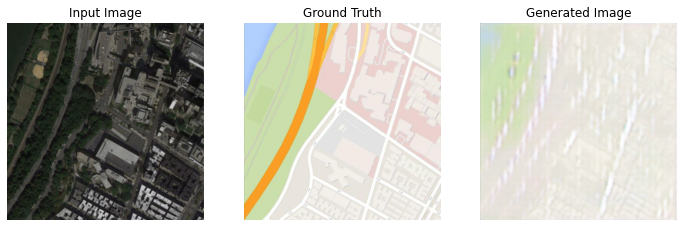

Epoch 50/100, time: 21.826965808868408s
Discriminator loss is 0.7990373373031616, Generator_loss is 3.6342716217041016
---------------------------------------------------------------------------------
Epoch 51/100, time: 21.426766395568848s
Discriminator loss is 0.5980677008628845, Generator_loss is 3.8404932022094727
---------------------------------------------------------------------------------
Epoch 52/100, time: 21.258212089538574s
Discriminator loss is 0.907990038394928, Generator_loss is 3.209980010986328
---------------------------------------------------------------------------------
Epoch 53/100, time: 21.274301528930664s
Discriminator loss is 0.8122620582580566, Generator_loss is 3.0241456031799316
---------------------------------------------------------------------------------
Epoch 54/100, time: 21.77436923980713s
Discriminator loss is 0.554518461227417, Generator_loss is 3.386178493499756
---------------------------------------------------------------------------------


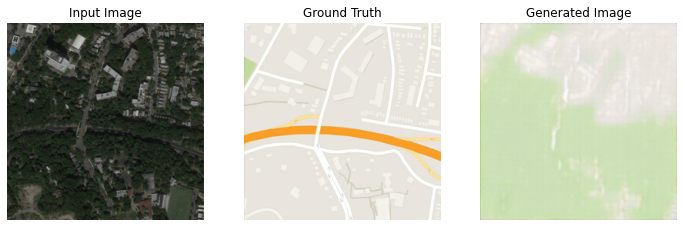

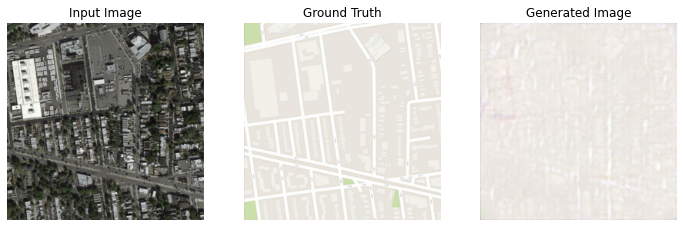

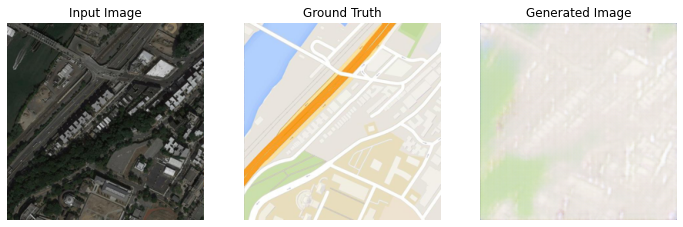

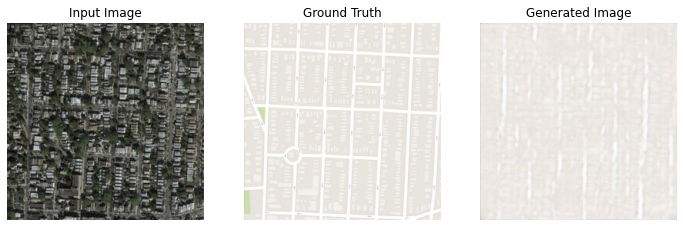

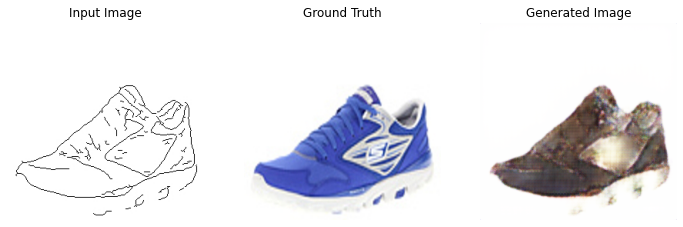

Epoch 55/100, time: 22.045084476470947s
Discriminator loss is 0.572278618812561, Generator_loss is 3.8710029125213623
---------------------------------------------------------------------------------
Epoch 56/100, time: 21.52356195449829s
Discriminator loss is 0.8605300188064575, Generator_loss is 3.0080552101135254
---------------------------------------------------------------------------------
Epoch 57/100, time: 21.347132921218872s
Discriminator loss is 0.9048043489456177, Generator_loss is 3.4709866046905518
---------------------------------------------------------------------------------
Epoch 58/100, time: 21.361130952835083s
Discriminator loss is 0.6478526592254639, Generator_loss is 3.0099849700927734
---------------------------------------------------------------------------------
Epoch 59/100, time: 21.291375875473022s
Discriminator loss is 1.051788330078125, Generator_loss is 3.1654248237609863
--------------------------------------------------------------------------------

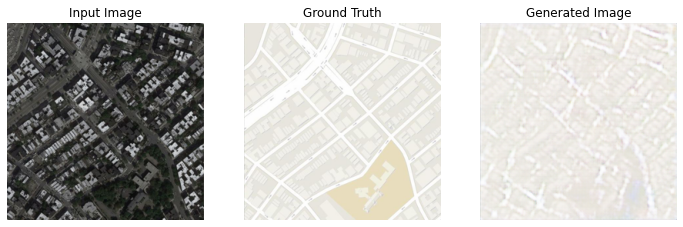

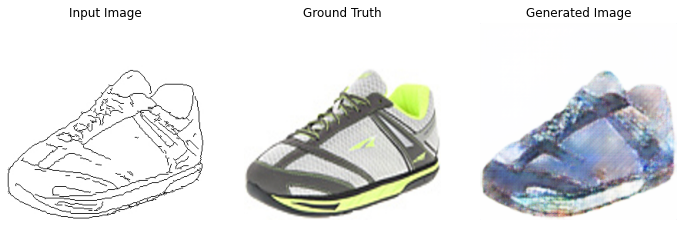

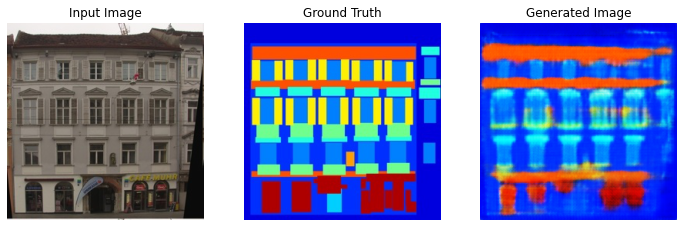

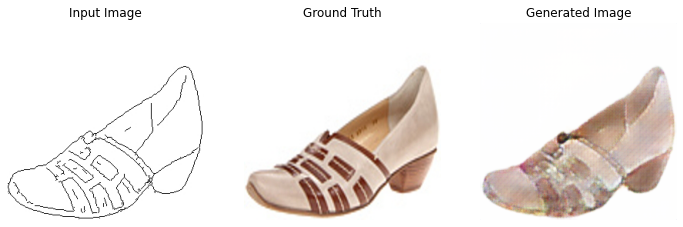

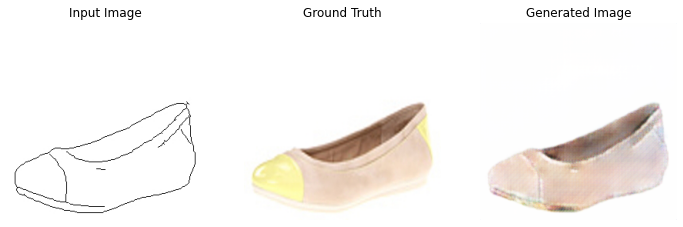

Epoch 60/100, time: 21.963229656219482s
Discriminator loss is 0.6788358688354492, Generator_loss is 3.517711639404297
---------------------------------------------------------------------------------
Epoch 61/100, time: 22.124319791793823s
Discriminator loss is 0.5310935378074646, Generator_loss is 3.407327175140381
---------------------------------------------------------------------------------
Epoch 62/100, time: 22.559028387069702s
Discriminator loss is 0.7003569602966309, Generator_loss is 3.3298747539520264
---------------------------------------------------------------------------------
Epoch 63/100, time: 22.163400173187256s
Discriminator loss is 0.7202591896057129, Generator_loss is 3.054793119430542
---------------------------------------------------------------------------------
Epoch 64/100, time: 21.711557865142822s
Discriminator loss is 0.5606073141098022, Generator_loss is 3.4704132080078125
--------------------------------------------------------------------------------

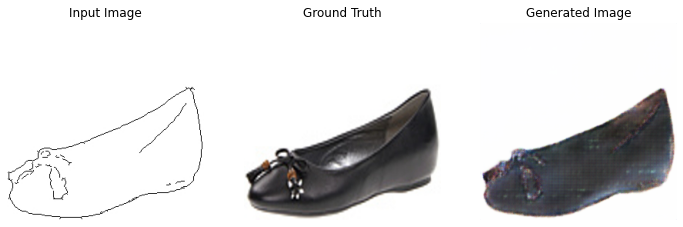

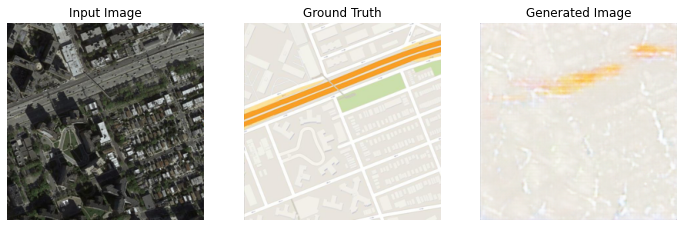

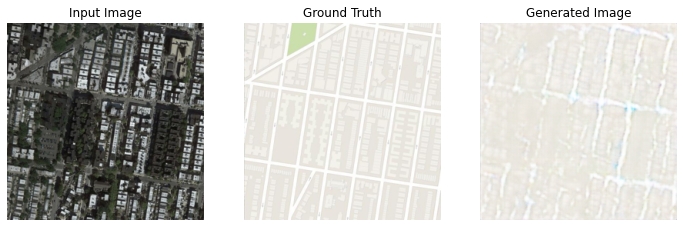

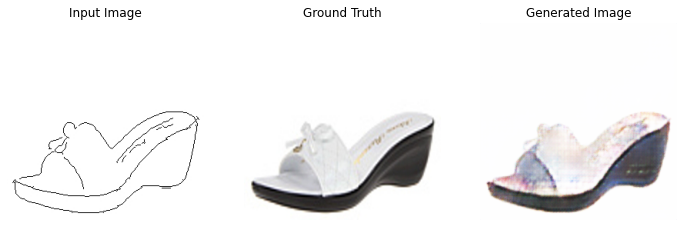

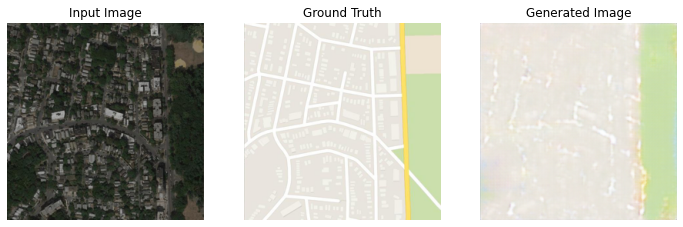

Epoch 65/100, time: 22.058969020843506s
Discriminator loss is 0.6053873300552368, Generator_loss is 2.9995999336242676
---------------------------------------------------------------------------------
Epoch 66/100, time: 22.194329500198364s
Discriminator loss is 0.6073586344718933, Generator_loss is 3.4302167892456055
---------------------------------------------------------------------------------
Epoch 67/100, time: 22.7011137008667s
Discriminator loss is 0.4704663157463074, Generator_loss is 3.2295494079589844
---------------------------------------------------------------------------------
Epoch 68/100, time: 22.066699266433716s
Discriminator loss is 0.8469011783599854, Generator_loss is 3.6185367107391357
---------------------------------------------------------------------------------
Epoch 69/100, time: 21.265136003494263s
Discriminator loss is 1.1756724119186401, Generator_loss is 2.7895593643188477
-------------------------------------------------------------------------------

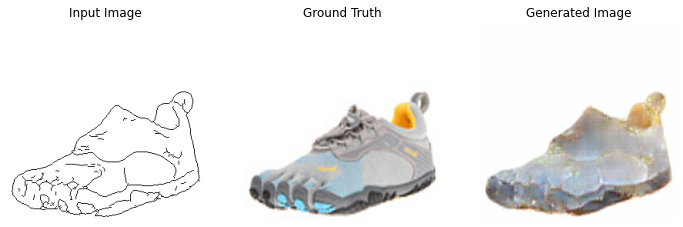

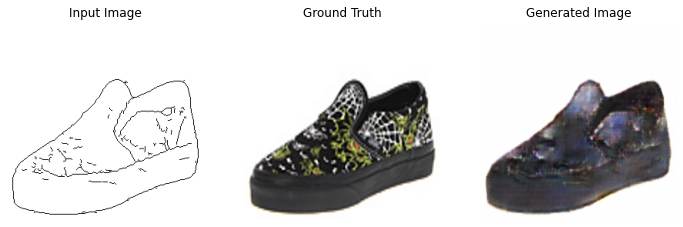

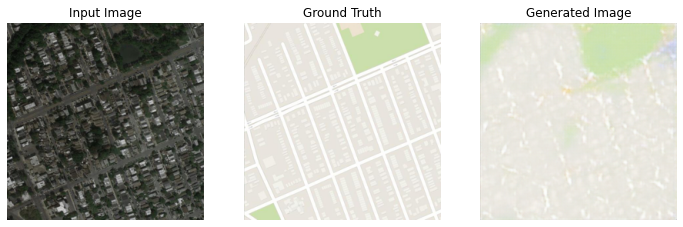

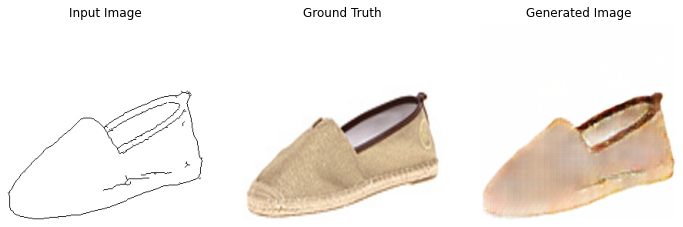

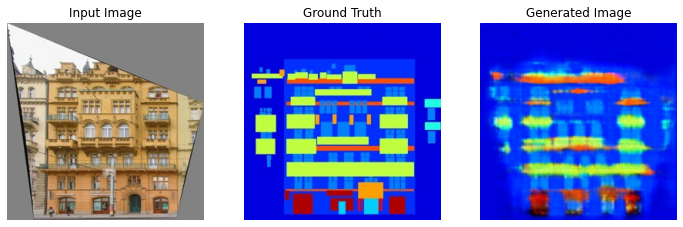

Epoch 70/100, time: 21.897891759872437s
Discriminator loss is 0.5550403594970703, Generator_loss is 3.1312782764434814
---------------------------------------------------------------------------------
Epoch 71/100, time: 21.63857388496399s
Discriminator loss is 0.6868100166320801, Generator_loss is 2.8730380535125732
---------------------------------------------------------------------------------
Epoch 72/100, time: 21.478678464889526s
Discriminator loss is 0.6382197141647339, Generator_loss is 2.9377317428588867
---------------------------------------------------------------------------------
Epoch 73/100, time: 21.256341218948364s
Discriminator loss is 0.8059270977973938, Generator_loss is 2.635643482208252
---------------------------------------------------------------------------------
Epoch 74/100, time: 21.297892093658447s
Discriminator loss is 0.9347397089004517, Generator_loss is 3.2304158210754395
-------------------------------------------------------------------------------

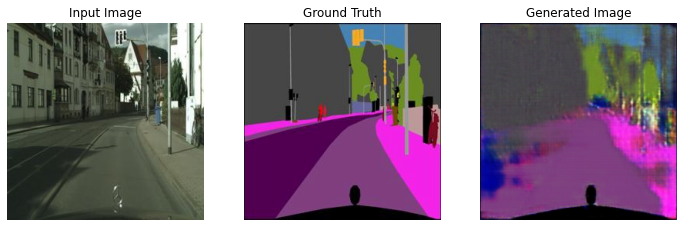

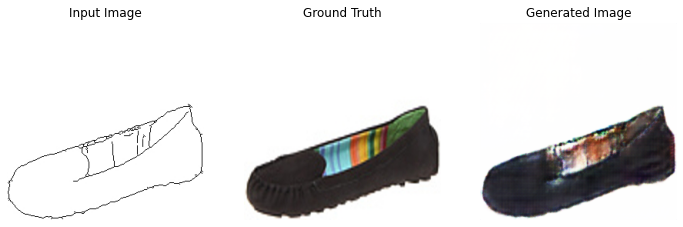

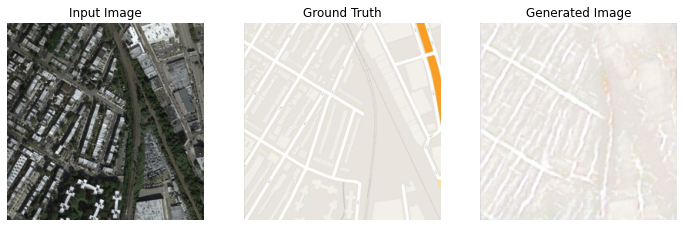

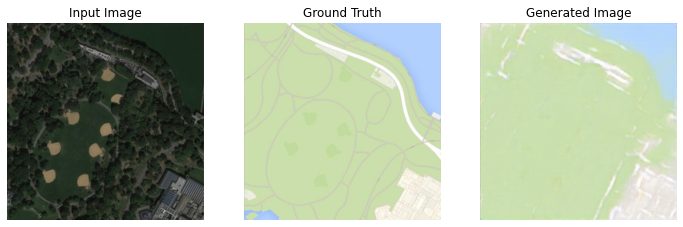

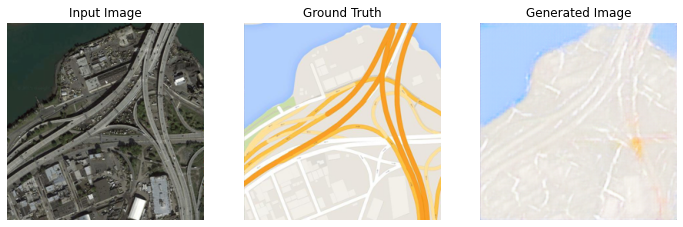

Epoch 75/100, time: 22.217860221862793s
Discriminator loss is 0.7673176527023315, Generator_loss is 2.904479503631592
---------------------------------------------------------------------------------
Epoch 76/100, time: 21.73164439201355s
Discriminator loss is 0.6038730144500732, Generator_loss is 3.2499613761901855
---------------------------------------------------------------------------------
Epoch 77/100, time: 21.388158559799194s
Discriminator loss is 0.707369327545166, Generator_loss is 3.0719850063323975
---------------------------------------------------------------------------------
Epoch 78/100, time: 21.29344940185547s
Discriminator loss is 0.8269556760787964, Generator_loss is 2.687744140625
---------------------------------------------------------------------------------
Epoch 79/100, time: 21.333462476730347s
Discriminator loss is 0.47157925367355347, Generator_loss is 3.407865285873413
---------------------------------------------------------------------------------


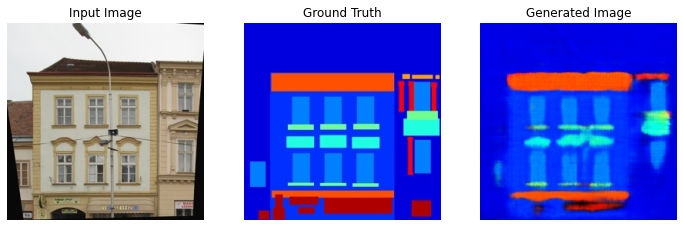

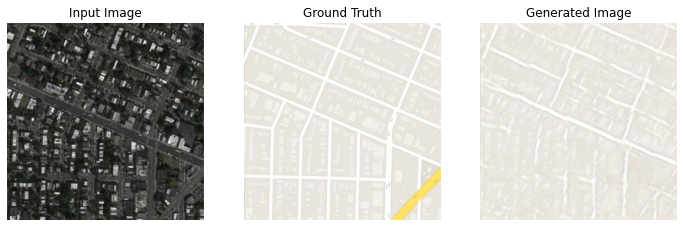

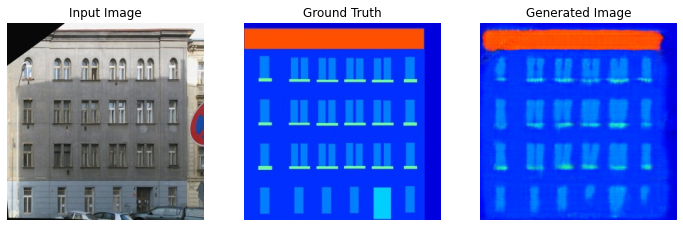

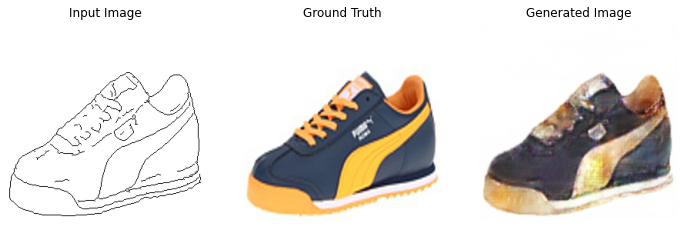

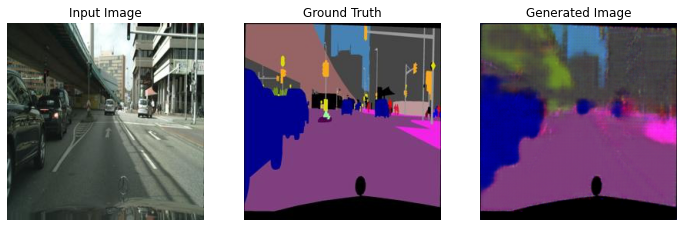

Epoch 80/100, time: 21.895421981811523s
Discriminator loss is 0.5816358327865601, Generator_loss is 2.8814167976379395
---------------------------------------------------------------------------------
Epoch 81/100, time: 21.478460788726807s
Discriminator loss is 0.56932532787323, Generator_loss is 2.821147918701172
---------------------------------------------------------------------------------
Epoch 82/100, time: 21.788952112197876s
Discriminator loss is 0.5840087532997131, Generator_loss is 2.9585258960723877
---------------------------------------------------------------------------------
Epoch 83/100, time: 21.8870370388031s
Discriminator loss is 0.7771545648574829, Generator_loss is 2.5878965854644775
---------------------------------------------------------------------------------
Epoch 84/100, time: 21.274089097976685s
Discriminator loss is 0.6813216209411621, Generator_loss is 2.5690131187438965
---------------------------------------------------------------------------------


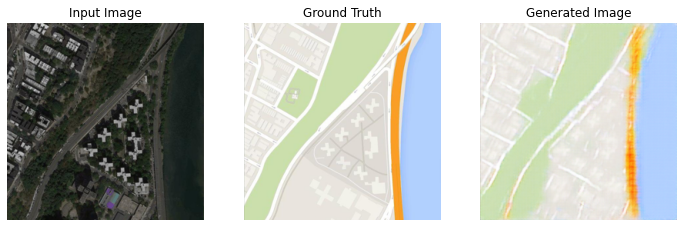

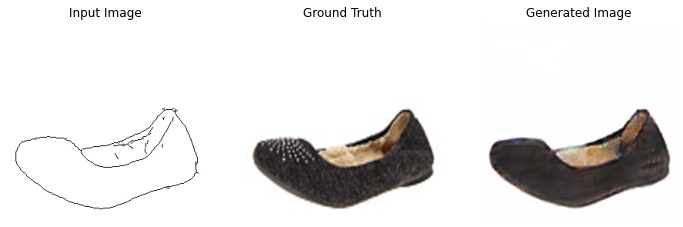

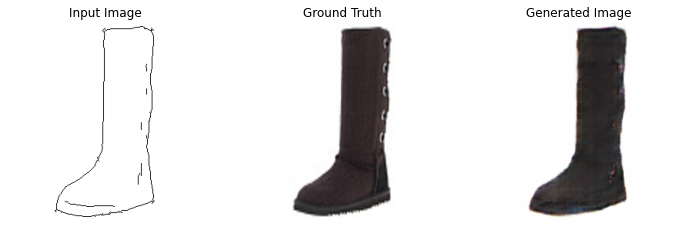

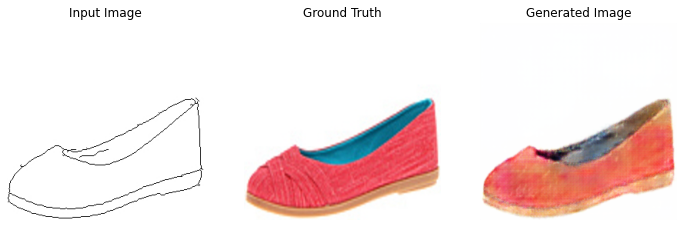

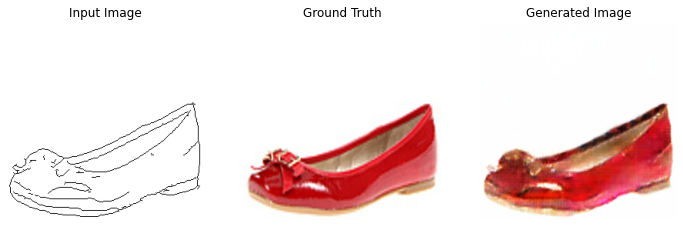

Epoch 85/100, time: 21.818063735961914s
Discriminator loss is 1.148971438407898, Generator_loss is 2.2637581825256348
---------------------------------------------------------------------------------
Epoch 86/100, time: 22.265581607818604s
Discriminator loss is 0.7318457365036011, Generator_loss is 2.7875633239746094
---------------------------------------------------------------------------------
Epoch 87/100, time: 21.828541040420532s
Discriminator loss is 0.8851262331008911, Generator_loss is 2.3649253845214844
---------------------------------------------------------------------------------
Epoch 88/100, time: 21.65131163597107s
Discriminator loss is 0.7551254034042358, Generator_loss is 2.826716899871826
---------------------------------------------------------------------------------
Epoch 89/100, time: 21.522892475128174s
Discriminator loss is 1.128173589706421, Generator_loss is 2.2702865600585938
---------------------------------------------------------------------------------

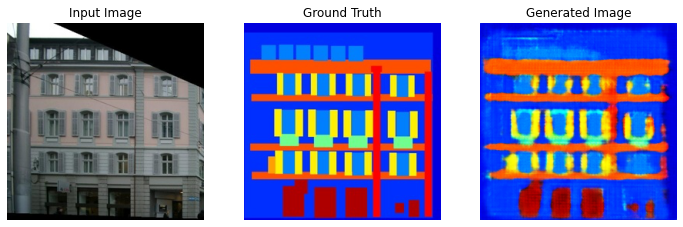

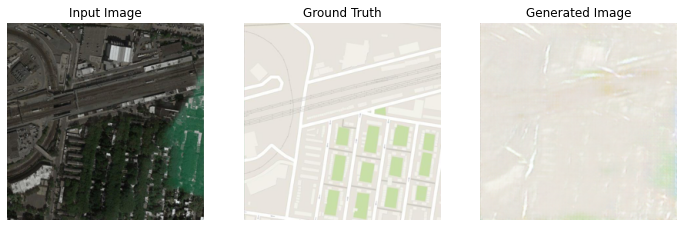

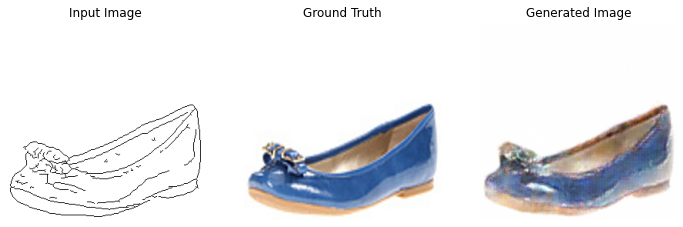

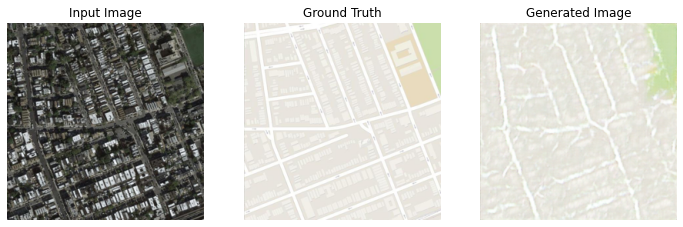

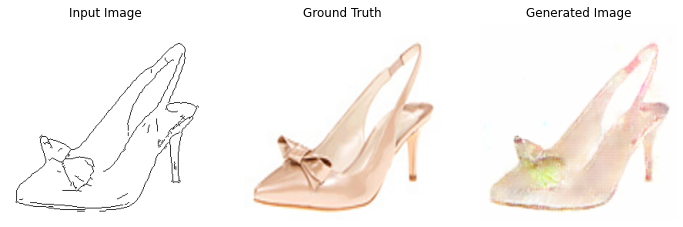

Epoch 90/100, time: 21.969812870025635s
Discriminator loss is 0.8297885656356812, Generator_loss is 2.384073257446289
---------------------------------------------------------------------------------
Epoch 91/100, time: 21.406984329223633s
Discriminator loss is 1.1556999683380127, Generator_loss is 2.2138617038726807
---------------------------------------------------------------------------------
Epoch 92/100, time: 21.287750482559204s
Discriminator loss is 1.0763951539993286, Generator_loss is 2.2850399017333984
---------------------------------------------------------------------------------
Epoch 93/100, time: 21.33605194091797s
Discriminator loss is 1.1317353248596191, Generator_loss is 2.45837140083313
---------------------------------------------------------------------------------
Epoch 94/100, time: 21.294973850250244s
Discriminator loss is 0.7385736703872681, Generator_loss is 2.5137386322021484
---------------------------------------------------------------------------------

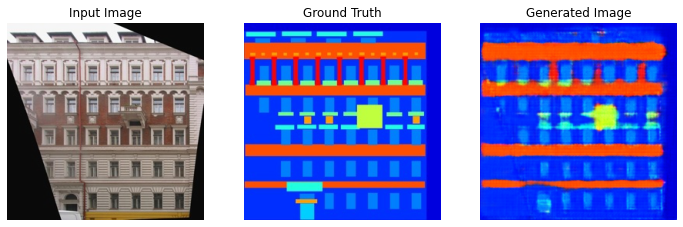

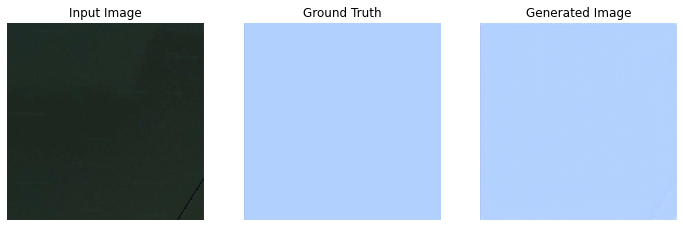

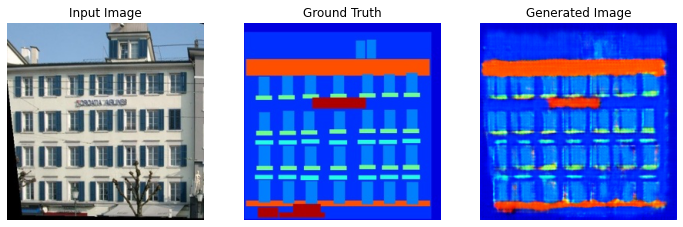

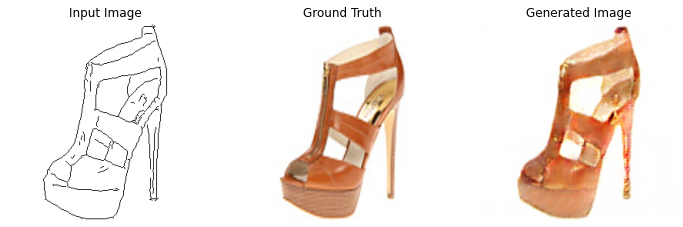

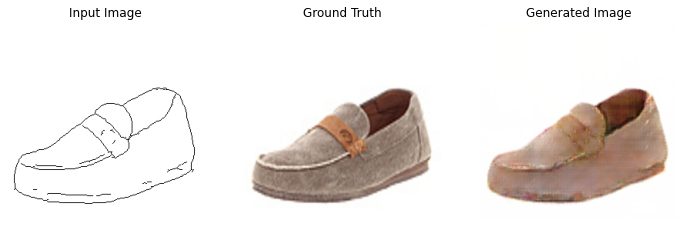

Epoch 95/100, time: 21.853909969329834s
Discriminator loss is 0.9478706121444702, Generator_loss is 2.8205084800720215
---------------------------------------------------------------------------------
Epoch 96/100, time: 21.347877025604248s
Discriminator loss is 0.8572210669517517, Generator_loss is 2.2906951904296875
---------------------------------------------------------------------------------
Epoch 97/100, time: 21.201619863510132s
Discriminator loss is 0.7274675369262695, Generator_loss is 2.5905680656433105
---------------------------------------------------------------------------------
Epoch 98/100, time: 21.30528235435486s
Discriminator loss is 0.705839991569519, Generator_loss is 2.546488046646118
---------------------------------------------------------------------------------
Epoch 99/100, time: 21.734143257141113s
Discriminator loss is 0.7118651866912842, Generator_loss is 2.688771963119507
---------------------------------------------------------------------------------

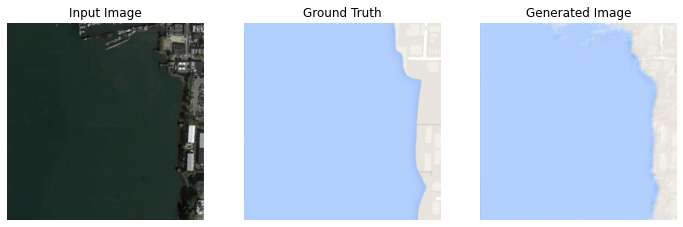

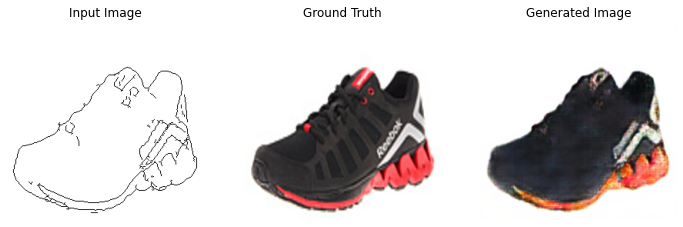

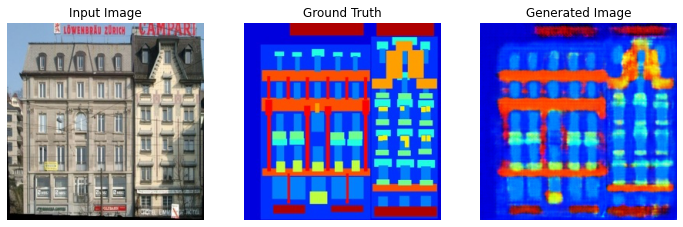

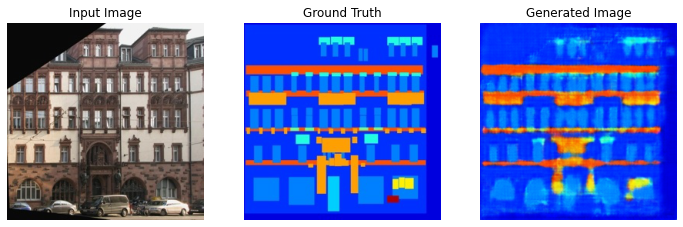

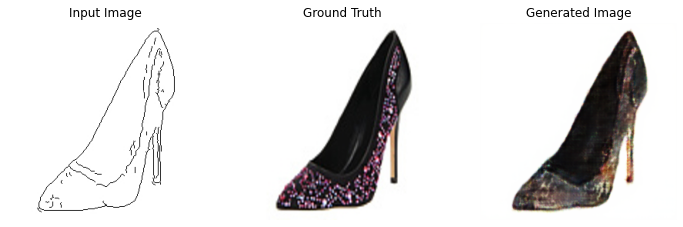

Epoch 100/100, time: 22.30966567993164s
Discriminator loss is 0.5137725472450256, Generator_loss is 2.763850212097168
---------------------------------------------------------------------------------
Total time of training is 2186.3921501636505


In [17]:
EPOCH = 100
history = train_gan(generator, discriminator,
                    dataset,
                    n_epochs=EPOCH,
                    show_image_epoch=5)

In [18]:
input_images, ground_truth, generated, d_loss_list, g_loss_list = history

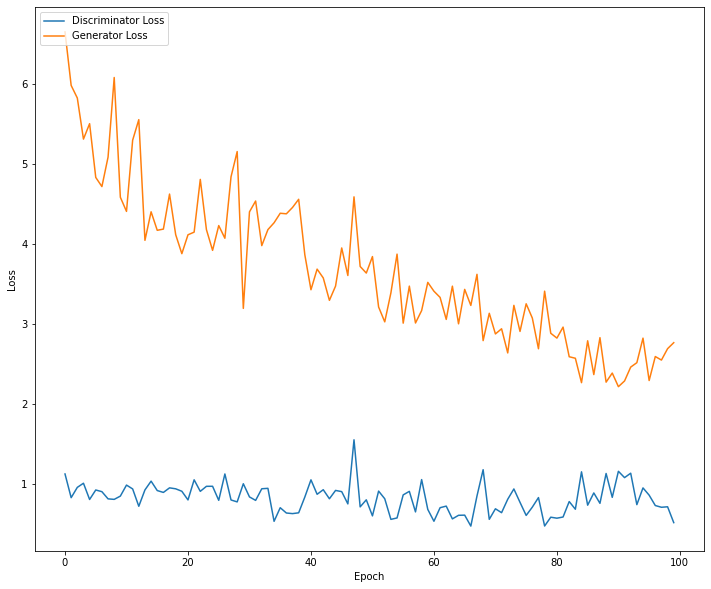

In [20]:
plt.figure(figsize=(12,10))
plt.plot(np.arange(len(d_loss_list)), d_loss_list, label='Discriminator Loss')
plt.plot(np.arange(len(g_loss_list)), g_loss_list, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper left')
plt.show()

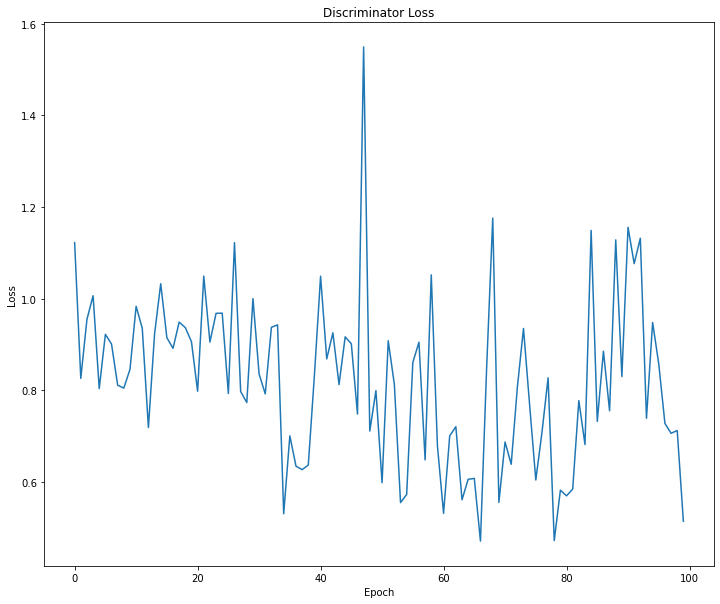

In [21]:
plt.figure(figsize=(12,10))
plt.plot(np.arange(len(d_loss_list)), d_loss_list)
plt.title('Discriminator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

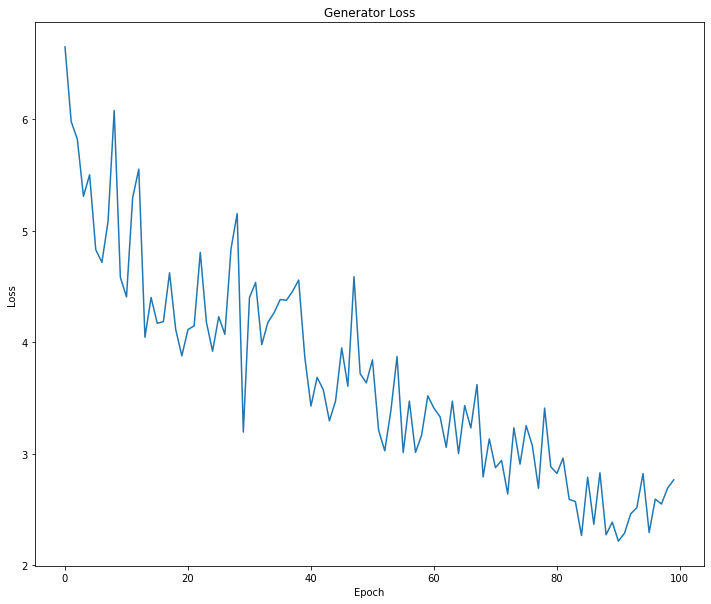

In [22]:
plt.figure(figsize=(12,10))
plt.plot(np.arange(len(g_loss_list)), g_loss_list)
plt.title('Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

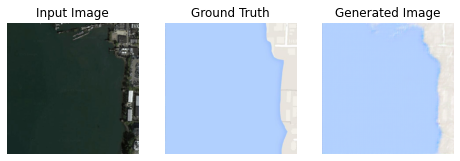

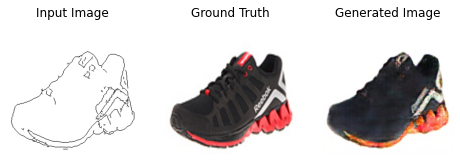

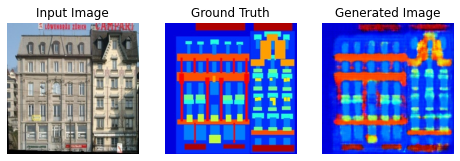

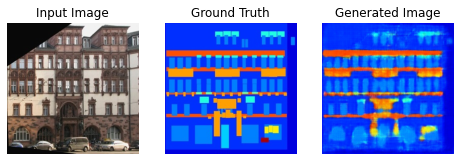

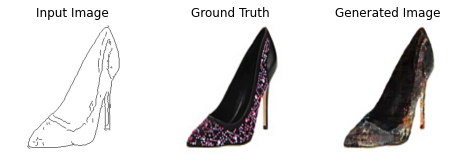

...

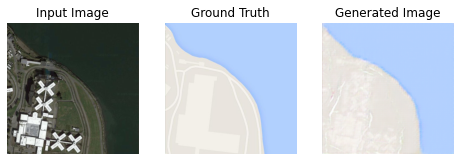

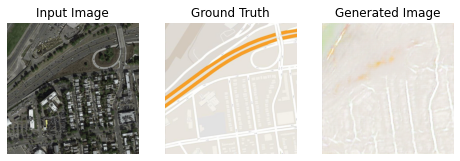

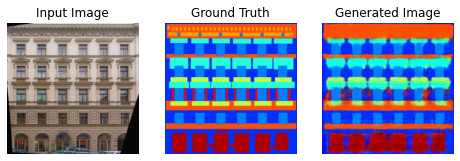

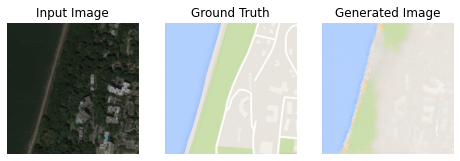

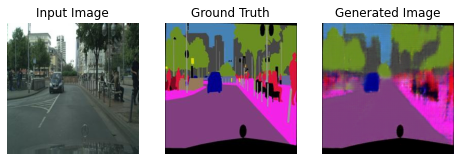

In [23]:
def show_result(ncols, inputs, gorund_truth, predicted):
    for i in range(ncols):
        plt.figure(figsize=(8,4))
        plt.subplot(131)
        org = img_normal(inputs[i])
        plt.imshow(org)
        plt.axis('off')
        plt.title('Input Image')
        plt.subplot(132)
        gt = img_normal(ground_truth[i])
        plt.imshow(gt)
        plt.axis('off')
        plt.title('Ground Truth')
        plt.subplot(133)
        pred = img_normal(predicted[i])
        plt.imshow(pred)
        plt.axis('off')
        plt.title('Generated Image')
        plt.show()
        
show_result(32, input_images, ground_truth, generated)